# A Neural Algorithm of Artistic Style
________________

Camusat Léa, \
Conesa Philippe, \
Ethève Eva, \
Gonzalez Julie, \
Roig Lila

**Copyright 2018 The TensorFlow Authors.**

In [ ]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

<table class="tfo-notebook-buttons" align="left">
  <td>
    <a target="_blank" href="https://www.tensorflow.org/tutorials/generative/style_transfer"><img src="https://www.tensorflow.org/images/tf_logo_32px.png" />View on TensorFlow.org</a>
  </td>
  <td>
    <a target="_blank" href="https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/generative/style_transfer.ipynb"><img src="https://www.tensorflow.org/images/colab_logo_32px.png" />Run in Google Colab</a>
  </td>
  <td>
    <a target="_blank" href="https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/style_transfer.ipynb"><img src="https://www.tensorflow.org/images/GitHub-Mark-32px.png" />View on GitHub</a>
  </td>
  <td>
    <a href="https://storage.googleapis.com/tensorflow_docs/docs/site/en/tutorials/generative/style_transfer.ipynb"><img src="https://www.tensorflow.org/images/download_logo_32px.png" />Download notebook</a>
  </td>
  <td>
    <a href="https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2"><img src="https://www.tensorflow.org/images/hub_logo_32px.png" />See TF Hub model</a>
  </td>
</table>

# Introduction

<font color = '34388e'> Le **Neural style transfer** est une technique de deep learning permettant d'appliquer à une image le style d'une autre image. Cette méthode d'optimisation prend en entrée deux images, une image de contenu (comme une photographie) et une image de style (comme une oeuvre d'art célèbre) et les mélange de sorte que l'image de sortie ressemble à l'image de contenu, mais "peinte" dans le style de l'image de style.

<font color = '34388e'>  Ce tutoriel permet d'implémenter l'algorithme de *style transfer* original en se basant sur l'article <a href="https://arxiv.org/abs/1508.06576" class="external">A Neural Algorithm of Artistic Style</a> (Gatys et al.).  
Des approches modernes beaucoup plus rapides (jusqu'à 1000x) entraînent un modèle pour générer directement l'image stylisée (similaire à [CycleGAN](./cyclegan.ipynb)). 

<font color = '34388e'> La méthode de **Neural style transfer** repose sur l'utilisation de  **Réseaux de  neurones Convolutionnels (CNN)**. Les CNN sont les réseaux de neurones profonds les plus performants dans les tâches de traitement d'image. 

<font color = '34388e'> Les CNN sont composés d'une succession de couches de convolution. Plus il y a un nombre important de couches, plus le réseau est profond. Chaque couche de convolution applique des opérations de convolutions sur son entrée via un filtre de taille plus petite que l'image. Ce filtre est déplacé sur l'image le long des pixels (en ligne et en colonne), ainsi chaque convolution est appliquée sur une sous partie de l'image et donne un scalaire. 

<font color = '34388e'>Chaque couche de convolution est caractérisée par différents paramètres : 
- <font color = '34388e'>**nombre de filtres** : chaque couche du réseau peut appliquer de multiples filtres sur ses données d'entrée. Appliquer un filtre sur une image consiste à effectuer une convolution d'une certaine partie de l'image. Ceci consiste à multiplier chacun des pixels d'une partie de l'image par un certain noyau. Le fait d'utiliser plusieurs filtres permet de découvrir des caractéristiques différentes de l'image. 
  
- <font color = '34388e'>**taille du filtre** : Selon la taille du filtre, chaque opération de convolution est effectuée sur une partie plus ou moins grande de l'image. Le filtre doit avoir le même nombre de channel que l'image d'origine. Dans le cadre de ce projet on traite des images RGB qui ont donc 3 canneaux. Les filtres des couches de convolution seront donc de profondeur 3. 
  
- <font color = '34388e'>**fonction d'activation** : Pour un neurone donné, cette fonction décide quand l'input parvient au neurone, si celui-ci est activé ou non. Cela revient à décider si l'apport de ce neurone dans le réseau est important ou  non et permet donc de supprimer des points de données inutiles. 
  
- <font color = '34388e'>**padding** : Par défaut le padding vaut 0, alors si on note (w,h) la taille de l'entrée, la taille de l'image obtenue en sortie sera (w-1,h-1). Si le padding = 1, alors un contour de 0 est rajouté autour de l'image d'entrée, de manière à ce que l'image de sortie soit de même taille (w,h) que l'entrée. 
  
- <font color = '34388e'>**stride** : Le stride est le nombre de pixels dont on déplace le filtre à chaque convolution, par défaut il vaut 1. Un stride de 2 permet de diviser la taille de l'image par 2. 


\\

<font color = '34388e'> Le résultat d'un filtre de convolution appliqué à une image d'entrée est appelé `feature map`. Ainsi, comme plusieurs filtres sont appliqués sur l'image dans chaque couche du réseau, la sortie d'une couche est composée de plusieurs `features maps`, comme illustré sur la **figure 1**: 

<center> <img src= "https://drive.google.com/uc?id=1fw6Peq4zGFIeaqZBlanpyTbq_IDs0kKj" width=650></center>
<caption><center><b>Figure 1:</b> Architecture d'une couche $l$ du CNN. </center></caption>

<font color = '34388e'> Dans la **figure 1** ci-dessus: 
-  <font color = '34388e'> La fonction $\phi$ est la fonction d'activation (ReLU).
- <font color = '34388e'> $N_l$ est le nombre de filtres de la couche $l$. 
- <font color = '34388e'> $M_l = M_{l_1} \times M_{l_2}$ est la taille d'une `feature map`. Une `feature map` est la réponse d'un filtre de convolution $f_i$ appliqué à l'image $\vec{x}$ et représente l'image encodée par le réseau.  
- La matrice $F^l \in \mathcal{R}^{M_l \times N_l}$ est l'ensemble des `features maps` de la couche $l$ et représente donc la réponse de tous les filtres de la couche $l$ appliqués à l'image $\vec{x}$. Il s'agit de la représentation des features (ou caractéristiques) de l'image $\vec{x}$ en sortie de la couche $l$.
- <font color = '34388e'> $F_{ik}^l$ est le $k$ème élément de la `feature map` $i$ de la couche $l$ avec $1 \le i \le N_l$ et $1 \le k \le M_l$.

Afin d'illlustrer le *style transfer* on prend par exemple l'image d'un chien et la composition 7 de Wassily Kandinsky :

<img src="https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg" width="500px"/>

[Yellow Labrador Looking](https://commons.wikimedia.org/wiki/File:YellowLabradorLooking_new.jpg), issu Wikimedia Commons by [Elf](https://en.wikipedia.org/wiki/User:Elf). License [CC BY-SA 3.0](https://creativecommons.org/licenses/by-sa/3.0/deed.en)

<img src="https://storage.googleapis.com/download.tensorflow.org/example_images/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg" width="500px"/>


On montre à présent le résultat *style transfer*, si Kandinsky décidait de peindre le tableau du chien : 

<img src="https://tensorflow.org/tutorials/generative/images/stylized-image.png" style="width: 500px;"/>

# Implémentation de l'algorithme *Neural Style transfer* 

## Importation et configuration des modules

Nous téléchargeons tout d'abord les modules nécessaires.

In [ ]:
# Importer les librairies nécessaires
# --------------------------------------
import os
import tensorflow as tf
# Load compressed models from tensorflow_hub
os.environ['TFHUB_MODEL_LOAD_FORMAT'] = 'COMPRESSED'

In [ ]:
import IPython.display as display

import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12, 12)
mpl.rcParams['axes.grid'] = False

import numpy as np
import PIL.Image 
import PIL.Image as Image
import time
import functools

In [ ]:
# Chargement google drive
# --------------------------------------
from google.colab import drive
drive.mount('/content/drive')

# Chemin d'accès aux images du drive
# --------------------------------------
PATH = '/content/drive/My Drive/' + "HDDL_COLAB/images"

os.chdir(PATH)

Mounted at /content/drive


In [ ]:
# Affichage des données contenues dans le dossier PATH
!ls

cactus.jpg
einstein.jpg
frida_khalo.jpg
fruits.jpg
illusion_optique.jpg
joconde.jpg
julia.jpg
laitiere.jpg
loss
marilyn.jpg
photo_corse.jpg
photo_style_corse_signac_alpha5beta20.png
photo_style_corse_signac_alpha5beta5000.png
photo_style_corse_signac_alpha5_beta500.png
photo_style_corse_signac_beta40.png
picasso.jpg
pointillisme.png
simpson.jpg
style_portraits
stylized-image2.png
stylized-image.png
test_alpha_beta_total_variation_loss_conv
test_on_convolutional_layers
test_portraits
tests_alpha_beta_content_noise
test_total_variation_loss
vangogh.jpg


Puis, nous téléchargeons une image de style et une image de contenu : 

In [ ]:
# Chargement de l'image pour le contenu
content_path = tf.keras.utils.get_file('YellowLabradorLooking_new.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg')
# Chargement de l'image pour le style
style_path = tf.keras.utils.get_file('kandinsky5.jpg','https://storage.googleapis.com/download.tensorflow.org/example_images/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg')

INITIAIZATION_WHITE_NOISE = False 

195196/195196 [==============================] - 0s 0us/step


## Fonctions pour visualiser l'image

Les fonctions ci-dessous permettent de visualiser les images d'entrée : 

In [ ]:
def tensor_to_image(tensor):
  """
  Cette fonction convertit un tenseur donné en entrée en
  une image.
  """
  tensor = tensor*255
  tensor = np.array(tensor, dtype=np.uint8)
  if np.ndim(tensor)>3:
    assert tensor.shape[0] == 1
    tensor = tensor[0]
  return PIL.Image.fromarray(tensor)

In [ ]:
def load_img(path_to_img):
  """
  Cette fonction charge une image et limite sa taille maximale à 512 pixels.
  Inputs: 
  - path_to_imag (str): chemin vers l'image à charger
  Outputs:
  - img: image chargée limitée à 512 pixels.
  """
  max_dim = 512
  img = tf.io.read_file(path_to_img)
  img = tf.image.decode_image(img, channels=3)
  img = tf.image.convert_image_dtype(img, tf.float32)

  shape = tf.cast(tf.shape(img)[:-1], tf.float32)
  long_dim = max(shape)
  scale = max_dim / long_dim

  new_shape = tf.cast(shape * scale, tf.int32)

  img = tf.image.resize(img, new_shape)
  img = img[tf.newaxis, :]
  return img

In [ ]:
def imshow(image, title=None):
  """
  Cette fonction permet d'afficher une image.
  """
  if len(image.shape) > 3:
    image = tf.squeeze(image, axis=0)
  plt.imshow(image)
  if title:
    plt.title(title)

(1, 336, 512, 3)


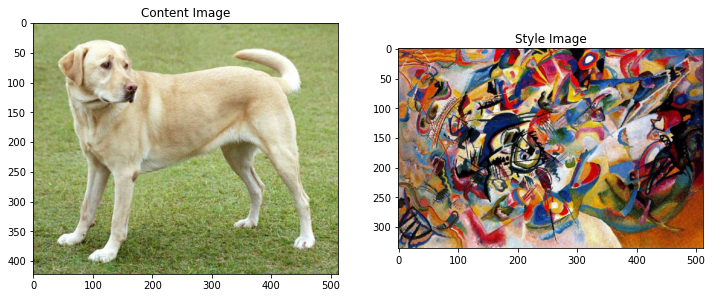

In [ ]:
# Affichage des images de Contenu et de Style
# ----------------------------------
content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image') #image de contenu

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image') #image de style

print(style_image.shape)

## *Style Transfer* rapide avec l'algorithme de TF-Hub


<font color = '34388e'>  Comme évoqué plus haut, ce tutoriel permet d'implémenter l'algorithme de *style transfer* original qui optimise le contenu de l'image en fonction d'un style particulier.
Pour appliquer le *style transfer* de manière plus simple, il est également possible d'utiliser un modèle pré-entraîné [TensorFlow Hub model](https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2) issu de [TensorFlow Hub](https://tfhub.dev) comme illustré dans le tutoriel [Fast style transfer for arbitrary styles](https://www.tensorflow.org/hub/tutorials/tf2_arbitrary_image_stylization) qui utilise un [modèle de stylisation d'image arbitraire](https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2). 

<font color = '34388e'> Le tutoriel [Transfert de style artistique avec TensorFlow Lite](https://www.tensorflow.org/lite/examples/style_transfer/overview) donne un exemple de transfert de style avec [TensorFlow Lite](https://www.tensorflow.org/lite).

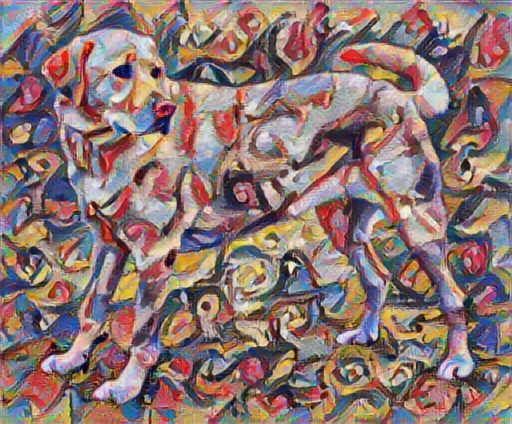

In [ ]:
# Chargement d'un modèle de transfert de style déjà entrainé sur TensorFlow Hub:
import tensorflow_hub as hub
hub_model = hub.load('https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2')
stylized_image = hub_model(tf.constant(content_image), tf.constant(style_image))[0]
tensor_to_image(stylized_image)

## Le réseau VGG19

<font color = '34388e'>  L'algorithme proposé pour le transfert de style se base sur le réseau de neurones [VGG19](https://keras.io/api/applications/vgg/#vgg19-function) présenté dans la **figure 2**, dont il extrait certaines couches.
Ce réseau de neurones a été préalablement entrainé sur la base de données *ImageNet* qui contient 1000 classes et 1.2 millions d'images. Ce réseau est constitué de 16 couches de convolutions et 5 couches de pooling pour un total de 19 couches. 


<center> <img src= "https://drive.google.com/uc?id=1VPtpS3etRhGBs_GrvE_fX7BBpZXGi0SC" width=800></center>
<caption><center><b>Figure 2:</b> Architecture du VGG19 où 3x3 Conv 1_1, 64 représente une couche de convolution constituée de 64 filtres de taille 3x3. Au fur et à mesure du réseau, le nombre de filtres de convolution utilisés augmente tandis que la taille des images en sortie de ces filtres diminue car elle est réduite par des méthodes de downsampling comme le max-pooling par exemple.</center></caption>


<font color = '34388e'>  Nous chargeons le modèle [VGG19](https://keras.io/api/applications/vgg/#vgg19-function) et le testons sur notre image pour nous assurer qu'il est utilisé correctement :

In [ ]:
# On fait le pre-processing propre au VGG19. 
# Attention : les images en entrée du préprocesing doit être entre 0 et 255
x = tf.keras.applications.vgg19.preprocess_input(content_image*255) 

# Si on veut faire de l'inférence pour classifier des images avec VGG19 en transfer learning, 
# on doit préalablement re dimensionner les images en 224x224. 
# (cela correspond à la taille des images sur lequel l'apprentissage a été fait).
x = tf.image.resize(x, (224, 224)) 

# On récupère les poids par transfer learning qui ont été appris sur la grande base de données Imagenet.
# Imagenet contient des images 1.2 millions d’images de 1000 classes différentes. 
# includeTop=True car on récupère le dense layer de manière à pouvoir faire de la prédiction parmi les classes de Imagenet
vgg = tf.keras.applications.VGG19(include_top=True, weights='imagenet') 

# On récupère les probabilités de la sortie softmax 
# On a la probabilité que l'image x appartienne à chacune des classes
prediction_probabilities = vgg(x)
# On a bien un vecteur de probabilité de taille 1000 (pour chacune des classes)
prediction_probabilities.shape 

574710816/574710816 [==============================] - 4s 0us/step


TensorShape([1, 1000])

In [ ]:
# Récupérer quelles sont les 5 classes les plus probables pour l'image x
predicted_top_5 = tf.keras.applications.vgg19.decode_predictions(prediction_probabilities.numpy())[0]
# Prédictions faites dans l'ensemble des 1000 classes de ImageNet. 
[(class_name, prob) for (number, class_name, prob) in predicted_top_5]

35363/35363 [==============================] - 0s 0us/step


[('Labrador_retriever', 0.49317136),
 ('golden_retriever', 0.23665282),
 ('kuvasz', 0.036357533),
 ('Chesapeake_Bay_retriever', 0.024182757),
 ('Greater_Swiss_Mountain_dog', 0.01864606)]

Nous chargeons à présent `VGG19` sans le bloc final de classification, et nous listons le nom des couches de `VGG19`.

In [ ]:
# Le paramètre include_top=False correspond au fait que cette fois ci on ne récupère pas la couche 
# dense car on récupère que les couches qui produisent des feature maps (structure convolutive)
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

# Affichage des différentes couches de convolution de VGG
for layer in vgg.layers:
  print(layer.name)

80134624/80134624 [==============================] - 0s 0us/step
input_2
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


## Définition de la représentation du contenu et du style

<font color = '34388e'> La sortie de chaque couche du réseau extrait une certaine caractéristique de l'image d'entrée et représente différentes versions filtrées de l'image d'entrée. Nous pouvons visualiser directement les informations que chaque couche contient sur l'image d'entrée en reconstruisant l'image uniquement à partir des `features maps` de cette couche. 

<font color = '34388e'> En effet, le réseau de neurones choisi a été pré-entraîné pour la classification d'images. Or, pour qu'un réseau puisse effectuer une classification, il est nécessaire qu'il comprenne l'image à haut niveau. Cela nécessite de prendre l'image brute comme pixels d'entrée et de construire une représentation interne qui convertit les pixels de l'image brute en une compréhension complexe des caractéristiques présentes dans l'image. \
Ainsi, le CNN sert d'extracteur de caractéristiques complexes. En accédant aux couches intermédiaires du modèle, nous sommes en mesure de décrire le contenu et le style des images d'entrée.

<font color = '34388e'> Plus on progresse au travers du réseau, plus les couches de convolutions extraient des caractéristiques (features) représentatives du contenu caché intrinsèque de l'image. La sortie des couches les plus profondes du réseau est utilisée pour récupérer du contenu de bas-niveau de la photographie. Les couches plus superficielles sont utilisées pour extraire le contenu de haut-niveau de la photographie et le style de l'image artistique, comme illustré par la **figure 3**. 

<center> <img src= "https://drive.google.com/uc?id=1DEsjQ5SK7-VF_jdihZVl3SHK8dJeYarC" width=800></center>
<caption><center><b>Figure 3:</b> Schéma global illustrant les couches du CNN utilisées pour le transfert de style du tableau $\vec{a}$ sur la photographie $\vec{p}$. Nous pouvons visualiser l'information (reconstruction du style ou reconstruction du contenu) d'une image d'entrée $\vec{p}$ ou $\vec{a}$ à différentes étapes du CNN à partir des feature maps obtenues à la sortie des différentes couches du réseau.</center></caption>

<font color = '34388e'>  L'algorithme de transfert de style se divise en **deux parties**. Les deux parties de l'algorithme sont associées à une fonction perte qui mesure respectivement la qualité de l'extraction du contenu de la photographie et la qualité de l'extraction du style du tableau : 

<font color = '34388e'>  **1 - Représentation du contenu :** 

<font color = '34388e'> La première partie vise à extraire le contenu de la photographie. 
La reconstruction du contenu de bas niveau reproduit les valeurs exactes des pixels de la photographie originale $\vec{p}$, tandis que la reconstruction du contenu de haut niveau détecte les objets et leur arrangement dans $\vec{p}$. Ainsi, la représentation du contenu d'une image est obtenue à partir des `feature maps` des couches supérieures (de haut niveau) du réseau. Une illustration plus détaillée est présentée dans la **figure 4**.\
Pour extraire le contenu, les auteurs de l'article extraient la deuxième couche de convolution du 5ème bloc de convolution intitulée `Conv5_2` sur la **figure 2**.

\

<center> <img src= "https://drive.google.com/uc?id=1JNI_mIVI3PMz-Lk8m-C5WrPAbIHhiopv" width=600></center>
<caption><center><b>Figure 4:</b> Schema illustrant la méthode de reconstruction de contenu de la photographie $\vec{p}$ à la couche $l$ du CNN.</center></caption>

\

<font color = '34388e'> Dans la **figure 4**, les `feature maps` $F^l$ et $P^l$ sont respectivement les *représentations de contenu* de l'image $\vec{x}$ et de la photographie $\vec{p}$ à la couche $l$. 
Pour reconstruire le contenu de la photographie $\vec{p}$ à partir des `feature maps` issues de la couche $l$ du CNN, on part d'une image bruit blanc $\vec{x}$ dans l'article. Puis on modifie cette image  $\vec{x}$ en minimisant une fonction perte $\mathcal{L}_{content}$ de façon à ce que $F^l \approx P^l$ c'est-à-dire de façon à ce que la représentation du contenu de l'image $\vec{x}$ à la couche $l$ soit proche de la représentation du contenu de la photographie $\vec{p}$ à la couche $l$. 

<font color = '34388e'> On utilise une descente de gradient pour minimiser la fonction perte suivante:
$$
\mathcal{L}_{content} (\vec{p},\vec{x},l) = \frac{1}{2} \sum_{i,k} (F_{ik}^l - P_{ik}^l)^2
$$

<font color = '34388e'> Le gradient de cette fonction perte par rapport à l'image $\vec{x}$ à la couche $l$ peut être calculé en utilisant la rétro-propagation du gradient. 



<font color = '34388e'>  **2 - Représentation du style :**

<font color = '34388e'>  La deuxième partie de l'algorithme vise à extraire le style d'un tableau artistique. \
Pour obtenir une représentation du style d'une image d'entrée, un espace des features est construit sur les sorties des filtres de convolution dans chaque couche du réseau comme illustré dans la **figure 5**. Cet espace des features est obtenu en calculant les corrélations entre les différentes `feature maps` dans les différentes couches du réseau. \
La représentation de style produit des versions texturées de l'image d'entrée $\vec{a}$ en capturant les couleurs et les structures globales de l'image sans prendre en compte l'information spatiale et la disposition précise des objets. Plus on avance dans le réseau et plus la taille et la complexité de la structure de la recontruction de style augmente car la complexité des `feature maps` obtenues par les filtres augmente. \
Pour extraire le style, les auteurs de l'article extraient et rangent consécutivement les `feature maps` des premières couches de chacun des cinq blocs de convolution nommés `conv1_1`, `conv2_1`, `conv3_1`, `conv4_1` et `conv5_1` sur la **figure 2**. 

\

<center> <img src= "https://drive.google.com/uc?id=1CTmo1UHsleaAwUnud4VOfrtSNSZthIzs" width=600></center>
<caption><center><b>Figure 5:</b> Schema illustrant la méthode de reconstruction de style du tableau $\vec{a}$ impliquant 3 couches de convolution.</center></caption>

\

<font color = '34388e'> Dans la **figure 5**, $G^l$ et $A^l$ sont respectivement les *représentations de style* de l'image $\vec{x}$ et du tableau $\vec{a}$ à la couche $l$. Ce sont les **matrices de Gram** des corrélations entre les `feature maps` de la couche $l$, dont nous détaillerons la construction plus bas.

<font color = '34388e'> Pour reconstruire le style du tableau $\vec{a}$ à partir des `feature maps` issues de la couche $l$ du CNN, on part d'une image bruit blanc $\vec{x}$ dans l'article. Puis on modifie cette image  $\vec{x}$ en minimisant une fonction perte $\mathcal{L}_{style}$ de façon à ce que $G^l \approx A^l$ c'est-à-dire de façon à ce que la représentation du style de l'image $\vec{x}$ à la couche $l$ soit proche de la représentation du style du tableau $\vec{a}$ à la couche $l$. Contrairement à précedemment avec la réprésentation de contenu, la fonction $\mathcal{L}_{style}$  est une "somme" des représentations de style de plusieurs couches du réseau et se calcule comme suit :

<font color = '34388e'> 
$$ 
\mathcal{L}_{style} (\vec{a},\vec{x})= \sum_{l=0}^{L} w_l E_l. 
$$

<font color = '34388e'> où :
-  <font color = '34388e'> $E_l$ est la contribution de la couche $l$ à la perte  $\mathcal{L}_{style}$ : $E_l = \frac{1}{4 N_l^2 M_l^2} \sum_{i,j} (G_{ij}^l - A_{ij}^l)^2$ 

- <font color = '34388e'> $w_l$ est le poids de la contribution de chaque couche à la perte totale 

- <font color = '34388e'> $L = 16$ (le nombre de couches de convolution du VGG19)


<font color = '34388e'> Le gradient de cette fonction perte par rapport à l'image $\vec{x}$ dans les couches $1 \le l \le L$ peut être calculé en utilisant la rétro-propagation du gradient. 




<font color = '34388e'> **Perte totale** :  

<font color = '34388e'> Enfin, pour générer des images qui mélangent le contenu d'une photographie $\vec{p}$ avec le style d'un tableau $\vec{a}$, les auteurs minimisent conjointement la distante d'une image bruit blanc $\vec{x}$ par rapport à la représentation de contenu de la photographie $\vec{p}$ dans **une** couche du réseau et à la représentation du style d'un tableau $\vec{a}$ dans **plusieurs** couches du réseau. Nous cherchons donc à minimiser la fonction perte totale :

<font color = '34388e'>
$$
    \mathcal{L}_{total} = \alpha \mathcal{L}_{content} + \beta \mathcal{L}_{style}
$$

<font color = '34388e'> La fonction perte totale du réseau est une somme pondérée des deux pertes $\mathcal{L}_{content}$ et $\mathcal{L}_{style}$.


<font color = '34388e'> Selon le poids accordé aux coefficients $\alpha$ et $\beta$, on accorde plus d'importance à l'extraction du style ou du contenu. Par exemple, si on accorde beaucoup plus de poids à $\alpha$ qu'à $\beta$, on devrait observer que la photographie initiale est facilement reconnaissable dans l'image obtenue, et que le style du tableau est peu présent. A l'inverse, si on accorde beaucoup plus de poids à $\beta$ qu'à $\alpha$, l'image obtenue sera très stylisée et les éléments de la photographie seront difficilement reconnaissables. 


<font color = '34388e'> Dans le code d'origine les paramètres fournis étaient $\alpha=\beta=1$, car l'algorithme partait directement de l'image correspondant au contenu. Ainsi, l'apprentissage était plus simple, car il suffisait "d'ajouter" le style à l'image. 



Comme indiqué ci-dessus, pour la représentation de **style**, nous visualisons la sortie (`features maps`) de **5** couches de convolution du CNN tandis que pour la représentation de **contenu**, nous visualisons la `feature map` issue d'**une** seule couche de convolution du CNN. \
Nous implémentons la fonction `select_layers` ci-dessous permettant de spécifier quelles couches (`features maps`)  nous souhaitons observer pour la représenter les style et le contenu des images :

In [ ]:
def select_layers(liste):
  """
  Cette fonction permet de spécifier quelles couches (= features maps) 
  nous souhaitons observer pour la représentation de style et de contenu. 

  Inputs:
  - liste: liste d'entiers indiquant quelles sorties de couches de convolution 
    (= feature maps) nous souhaitons observer pour la représentation de style. 
    Si nous voulons observer la sortie de 3 couches de convolution nous mettons 
    liste = [0,1,2], pour observer 5 couches: liste = [0,1,2,3,4]

  Outputs:
  - content_layers, style_layers: nom des couches de convolution pour lesquelles
    on visualise la reconstruction de contenu et de style.
  """

  # Couche pour représenter le contenu de l'image choisie selon l'article p. 12 
  content_layers = ['block5_conv2']  
  #content_layers = ['block4_conv2']  

  # Couches pour représenter le style de l'image selon l'article p. 11
  style_layers = np.array(['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']) 

  style_layers = list(style_layers[liste])
  return content_layers, style_layers

In [ ]:
# Appel à la fonction select_layers
# ---------------------------------
liste=[0, 1, 2, 3, 4]
content_layers, style_layers = select_layers(liste)

# Nombre de couches de contenu 
num_content_layers = len(content_layers) 
# Nombre de couches de style 
num_style_layers = len(style_layers)

## Construction du modèle

<font color = '34388e'>  Les réseaux de `tf.keras.applications` sont conçus de manière à ce que l'on puisse facilement extraire les valeurs des couches intermédiaires à l'aide de l'API fonctionnelle de Keras. Pour définir un modèle à l'aide de l'API fonctionnelle, nous devons spécifier les entrées et les sorties : `model = Model(inputs, outputs)`

<font color = '34388e'>  La fonction suivante `vgg_layers` construit un modèle VGG19 "réduit" qui prendra en entrée une image et qui renvoie uniquement les poids de certaines couches de convolution intermédiaires de VGG19, spécifiées par `layer_names`. Les couches de convolution renvoyées sont les 5 couches de convolution correspondant à la représentation de style (`conv1_1`, `conv2_1`, `conv3_1`, `conv4_1` et `conv5_1`) et la couche de convolution correspondant à la représentation de contenu ( `Conv5_2`)

In [ ]:
def vgg_layers(layer_names):
  """
  Creates a VGG model that returns a list of intermediate output values.
  Crée un VGG modèle nommé 'model' qui prendra en entrée une image et qui
  retourne les poids des couches de convolution (= feature maps) de VGG 
  pour les couches spécifiées par "layer_names".  
  """
  # Load our model. Load pretrained VGG, trained on ImageNet data
  # include_top=False pour ne pas récupérer la couche dense car on veut
  # uniquement les coucles qui produisent des feature maps (structure convolutive)
  vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

  # On fait du transfer learning : on ne réapprend aucun poids. Ils ne sont donc pas entraînables. 
  vgg.trainable = False
  # vgg.get_layer(name).output pour récupérer les poids de tous les blocs de convolution demandés.
  outputs = [vgg.get_layer(name).output for name in layer_names]

  # vgg.input: on spécifie au modèle la taille de l'input: 
  # l'entrée de 'model' à la même taille que l'entrée de 'vgg'
  model = tf.keras.Model([vgg.input], outputs)
  return model

<font color = '34388e'>  Une fois le modèle de `VGG19` "réduit" défini, nous l'instancions. Le modèle est donc constitué de 5 couches de convolution correspondant à la représentation de style (`conv1_1`, `conv2_1`, `conv3_1`, `conv4_1` et `conv5_1`) et d'une  couche de convolution correspondant à la représentation de contenu ( `Conv5_2`). 

In [ ]:
# VGG model qui une fois appliqué à une image,
# retournera les poids des couches de convolution (= feature maps) spécifiées 
# dans "style_layers". Ceci permettra de visualiser la représentation de style.
style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255) #on applique le modèle à l'image de style

# Look at the statistics of each layer's output
# On affiche les caractéristiques de chaque feature map 
# qu'on a obtenue en appliquant à l'image de style le modèle obtenu par transfer learning. 

for name, output in zip(style_layers, style_outputs): 
  print(name)
  print("  shape: ", output.numpy().shape)
  print("  min: ", output.numpy().min())
  print("  max: ", output.numpy().max())
  print("  mean: ", output.numpy().mean())
  print()

block1_conv1
  shape:  (1, 336, 512, 64)
  min:  0.0
  max:  835.5256
  mean:  33.97525

block2_conv1
  shape:  (1, 168, 256, 128)
  min:  0.0
  max:  4625.8857
  mean:  199.82687

block3_conv1
  shape:  (1, 84, 128, 256)
  min:  0.0
  max:  8789.239
  mean:  230.78099

block4_conv1
  shape:  (1, 42, 64, 512)
  min:  0.0
  max:  21566.135
  mean:  791.24005

block5_conv1
  shape:  (1, 21, 32, 512)
  min:  0.0
  max:  3189.2542
  mean:  59.179478



## Calcul du style de l'image

<font color = '34388e'> Comme évoqué plus haut, le **contenu** d'une image est représenté par les valeurs des `feature maps` dans **une** couche cachée du réseau. Le **style** d'une image peut être décrit par les moyennes et les corrélations entre les **plusieurs** `feature maps`. 

<font color = '34388e'> 
On rappelle que le produit scalaire entre deux vecteurs est important quand l'angle entre les deux vecteurs est faible ou que les coordonnées sont très peu différentes. \
La **matrice de Gram** $G_l \in \mathcal{R}^{N_l \times N_l}$ calcule les corrélations entre les `features maps` de la couche $l$ où $G_{ij}^l$ est le produit scalaire entre deux `features maps` préalablement vectorisées $F_i^l$ et $F_j^l$ à la couche $l$ et $IJ$ est le nombre de pixels de l'image : 

<font color = '34388e'> 
\begin{equation}
G_{ij}^l = \frac{\sum_k F_{ik}^l F_{jk}^l}{IJ}
\end{equation}

<font color = '34388e'> On se ramène donc au cas d'un produit scalaire entre deux vecteurs. On réalise cette opération entre chaque paire de `feature maps`. On fait en fait la moyenne sur tous les pixels de la somme de toutes les valeurs de la `feature map`.

<font color = '34388e'> On obtient alors une matrice de taille $N_l \times N_l$ où $N_l$ est le nombre de filtres, avec toutes les valeurs des corrélations de paire de features, comme illustré dans la **figure 6**.

<font color = '34388e'> Comme nous avons vectorisé l'image afin de calculer la **matrice de Gram**, nous avons perdu toute information spatiale ce qui garantit que l'on extrait bient la texture et non pas le contenu de l'image.

<center> <img src= "https://drive.google.com/uc?id=16NlVwR47FEKZMi5y0Wf-K6GGfK7LmLfu" width=800></center>
<caption><center><b>Figure 6:</b> Schema illustrant le calcul de la matrice de Gram $G^l$ à la couche $l$ du CNN.</center></caption>

<font color = '34388e'>  La fonction ci-dessous calcule la **matrice de gram** d'une `feature map`. Ceci peut être implémenté de manière concise en utilisant la fonction `tf.linalg.einsum` :

In [ ]:
def gram_matrix(input_tensor):
  """
  Calcul de la gram matrix d'un tenseur 

  Inputs: 
  - input tensor: tenseur de dimension 4 de taille 
    (1, height_feature_map, width_feature_map, nb_channels)
    La première dimension (1) est due au fait que l'on calcule la 
    matrice de Gram  d'un seul tenseur. 

  Outputs:
  - Matrice de Gram de taille (1, nb_channels, nb_channels) 
  """
  # result correspond au calcul du numérateur de la matrice de Gram (voir formule ci-dessus)
  result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor) 
  #'bijc,bijd->bcd' : (bcd = sum_ij bijc * bijd) renvoie un objet de taille (1, nb_channels_feature_map, nb_channels_feature_map)
  # c'est bien la taille d'une matrice de corrélation. 

  input_shape = tf.shape(input_tensor) 

  # Calcul du dénominateur de la matrice de Gram (voir formule ci-dessus)
  # I*J (hauteur x largeur de l'image)
  num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32) 
  return result/(num_locations)

## Extraction du style et du contenu



<font color = '34388e'>  La classe `StyleContentModel` ci-dessous construit un modèle qui renvoie les tenseurs de style et de contenu. Pour construire le modèle, on utilise la fonction `vgg_layers` qui a été définie plus haut et qui permet d'extraire les couches de convolution correspondant au style et au contenu. 

<font color = '34388e'>  La méthode `call` de `StyleContentModel` permet de calculer, sous forme de tenseurs, les **matrices de Gram** pour les `feature maps` correspondant à l'extraction de **style** ainsi les tenseurs correspondant à l'extraction de **contenu**. 

In [ ]:
class StyleContentModel(tf.keras.models.Model):
  def __init__(self, style_layers, content_layers):
    super(StyleContentModel, self).__init__()
    # vgg_layers: on prend le modèle VGG "réduit" aux couches de convolutions
    # (= feature maps) spécifiées par "layer_names"
    self.vgg = vgg_layers(style_layers + content_layers) #concaténation des deux listes de layers (contenu et style)
    self.style_layers = style_layers
    self.content_layers = content_layers
    self.num_style_layers = len(style_layers)
    self.vgg.trainable = False #on ne réentraine pas les poids de VGG: on fait du TRANSFER LEARNING 

  def call(self, inputs):
    "Expects float input in [0,1]"
    inputs = inputs*255.0 #on repasse les images entre 0 et 255
    preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs) #pré processing propre à vgg19
    outputs = self.vgg(preprocessed_input) #on applique le modèle aux images 

    # On récupère les features maps correspondant à la représentation de style et de contenu:
    style_outputs, content_outputs = (outputs[:self.num_style_layers],
                                      outputs[self.num_style_layers:]) #pour le content output, l'indice commence à num_style_layer 
                                      #parce que la couche de contenu est située juste après la dernière couche de style 
    
    # Calcule les gram matrix pour chaque tenseur (feature map) pour les couches de style
    style_outputs = [gram_matrix(style_output)
                     for style_output in style_outputs] 

    # Création d'un dictionnaire avec le nom de chaque couche et le tenseur de feature maps associé pour le contenu
    content_dict = {content_name: value
                    for content_name, value
                    in zip(self.content_layers, content_outputs)} 

    # Idem mais pour les couches de style avec les matrices de gram 
    style_dict = {style_name: value
                  for style_name, value
                  in zip(self.style_layers, style_outputs)} 

    # Renvoie un dictionnaire de dictionnaires, 
    # l'un correspondant au dictionnaire de style 
    # et l'autre correspondant au dictionnaire de contenu
    return {'content': content_dict, 'style': style_dict} 

Appliqué à une image, ce modèle renvoie la **matrice de Gram** (style) des `style_layers` et le contenu des `content_layers` :

In [ ]:
# Instanciation de la classe StyleContentModel qui va nous permettre 
# d'extraire les matricees de Gram et les feature maps. 
extractor = StyleContentModel(style_layers, content_layers) 

# appel de la fonction call de StyleContentModel
results = extractor(tf.constant(content_image))

print('Styles:')
for name, output in sorted(results['style'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())
  print()

print("Contents:")
for name, output in sorted(results['content'].items()):
  print("  ", name)
  print("    shape: ", output.numpy().shape)
  print("    min: ", output.numpy().min())
  print("    max: ", output.numpy().max())
  print("    mean: ", output.numpy().mean())

Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.005522845
    max:  28014.555
    mean:  263.79022

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  61479.49
    mean:  9100.949

   block3_conv1
    shape:  (1, 256, 256)
    min:  0.0
    max:  545623.44
    mean:  7660.976

   block4_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  4320501.5
    mean:  134288.84

   block5_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  110005.36
    mean:  1487.0378

Contents:
   block5_conv2
    shape:  (1, 26, 32, 512)
    min:  0.0
    max:  2410.879
    mean:  13.764149


## Exécuction de l'optimisation par descente de gradient

<font color = '34388e'>  Une fois les tenseurs contenant les **matrices de Gram** issues de la représentation de **style** et les tenseurs contenant la représentation de **contenu** calculés, nous pouvons implémenter l'algorithme de *style tranfer*. 
Pour ce faire, nous calculons l'erreur quadratique moyenne de la sortie de l'image par rapport à chaque target, puis nous prenons la somme pondérée de ces erreurs.

<font color = '34388e'>  Nous définissons dans la cellule ci-dessous les targets qui sont :
- les poids des couches de convolution (=`feature maps`) associées à la représentation de **style**. Il s'agit des **matrices de Gram**. 
- les poids des couches de convolution (=`feature maps`) associées à la représentation de **contenu**. 

In [ ]:
# Poids des couches de convolution (= feature maps) associées à la représentation de style
style_targets = extractor(style_image)['style']
# Poids des couches de convolution (= feature maps) associées à la représentation de contenu
content_targets = extractor(content_image)['content']

<font color = '34388e'>  Nous définissons une variable `image = tf.Variable` pour contenir l'image à optimiser. 

<font color = '34388e'>  Dans l'article, il est indiqué que l'image de départ est une image **bruit blanc** (notée $\vec{x}$ dans la **figure 3**). L'algorithme va alors modifier l'image bruit blanc de sorte que ses pixels s'approchent conjointement de la représentation de contenu dans **une** couche cachée du réseau et de la représentation de style dans **plusieurs** couches cachées du réseau. \
<font color = '34388e'>  Cependant, pour améliorer la vitesse de convergence de l'algorithme, nous l'initialisations dans ce tutoriel avec la représentation du contenu au lieu de l'image bruit blanc. 
<font color = '34388e'>  Le `tf.Variable` doit donc avoir la même forme que l'image du contenu.

In [ ]:
# Afin que l'algorithme converge plus rapidement, on ne lui donne pas une 
# image de bruit blanc comme indiqué dans l'article mais l'image de contenu
image = tf.Variable(content_image) 

<font color = '34388e'>  Nous implémentons également une fonction permettant de créer une image **bruit blanc** pour constituer le point de départ pour l'entraînement de l'algorithme de *style transfer*.

<font color = '34388e'>  Ceci va nous permettre de comparer la vitesse de convergence de l'algorithme lorsque l'initialisation est faite avec une image bruit blanc et lorsque l'on intitalise avec la représentation de contenu. 



In [ ]:
def create_grey_image(content_image):
  """
  Cette fonction permet de créer une image bruit blanc (comme indiqué dans 
  l'article) afin de constituer le point de départ pour l'entraînement
  de l'algorithme de transfert de style. 

  Inputs:
  - content_image: on veut créer une image de bruit blanc ayant la 
    même taille que l'image de contenu content_image

  Outputs:
  - image: image de bruit blanc
  """
  grey=np.random.normal(0, 1, content_image.shape[:3])
  img2 = np.zeros( ( np.array(grey).shape[0], np.array(grey).shape[1],np.array(grey).shape[2], 3 ) )
  img2[:,:,:,0] = grey #same value in each channel
  img2[:,:,:,1] = grey
  img2[:,:,:,2] = grey
  imshow(img2, 'noise image')

  img2=tf.convert_to_tensor(img2)
  image=tf.Variable(img2)
  return image

In [ ]:
if INITIAIZATION_WHITE_NOISE :
# Test de create_grey_image
  plt.figure(figsize = (6,6))
  image = create_grey_image(image)
  print("L'image d'initialisation est une image de bruit blanc et pas une image de contenu ")

<font color = '34388e'>  Comme il s'agit d'une image de type float, on difinit une fonction pour mettre les valeurs des pixels entre 0 et 1 :

In [ ]:
def clip_0_1(image):
  return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

Nous créons un optimiseur. L'article recommande l'optimiseur LBFGS, mais  ce tutoriel utilise Adam qui fonctionne également :

In [ ]:
opt = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

<font color = '34388e'>  La fonction `style_content_loss` ci-dessous calcule **la perte totale** qui est une somme pondérée de la perte liée à la représentation de contenu et de la perte liée à la représentation de style: $\mathcal{L}_{total} = \alpha \mathcal{L}_{content} + \beta \mathcal{L}_{style}$

In [ ]:
# on définit les poids qui pondèrent la loss totale.
style_weight=10**(-2) # alpha (dans l'article)
content_weight=1e4 # beta (dans l'article)

In [ ]:
def style_content_loss(outputs,style_weight,content_weight):
  """
  Cette fonction calcula la total loss: L_total = alpha*L_content + beta*L_style

  Inputs:
  - outputs: dictionnaire de dictionnaires. Le premier dictionnaire contient 
    les matrices de gram pour les couches de style et le deuxième dictionnaire 
    contient les feature maps pour les couche de contenu. 
  - style_weight: alpha (dans l'article): poids de la représentation du syle
  - content_weight: beta (dans l'article): poids de la représentation de contenu.

  Outputs:
  - loss: total loss.
  """
  style_outputs = outputs['style']
  content_outputs = outputs['content']

  #------ style loss 
  style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                        for name in style_outputs.keys()]) 
  
  # 1/num_style_layers est égal au w_l de l'article présenté page 12
  style_loss *= 1/num_style_layers 

  #------ content loss
  # Le calcul ci-dessous correspond à l'équation 1 page 10. 
  # On fait la différence entre la feature map de l'image 
  # d'origine et celle de l'image qu'on veut apprendre et on somme sur toutes les positions 
  # de tous les filtres 
  content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                          for name in content_outputs.keys()])
  
  # par rapport au papier il y a un facteur 1/2 en moins. Ca ne change au final rien. 
  # C'est juste plus facile pour les calculs de dérivée. 
  content_loss *= 1/num_content_layers 

  #------ total loss
  loss = style_weight * style_loss + content_weight *content_loss

  return loss, style_loss, content_loss

<font color = '34388e'>  La fonction `train_step` calcule une étape d'entraînement de l'algorithme de *style transfer*. 
On utilise `tf.GradientTape` pour mettre à jour l'image :

In [ ]:
@tf.function()

def train_step(image,style_weight,content_weight):
  """
  Fonction définissant un step d'entraînement. 
  Inputs:
  - image: image que l'on va transformer au fur et à mesure de 
    l'entraînement pour qu'elle s'approche de l'image de style
    et du contenu. 
  """
  # Calcule la dérivée de la total loss
  with tf.GradientTape() as tape: # pour dire que l'on veut faire de la différenciation automatiqueµ
    outputs = extractor(image) 
    loss, style_loss, content_loss = style_content_loss(outputs,style_weight,content_weight) # fonction de la variable selon laquelle on veut dériver. 
    
  grad = tape.gradient(loss, image) # dérivée de loss selon la variable image 
  opt.apply_gradients([(grad, image)]) # faire une descente de gradient avec les paramètres de l'optimiseur (adam) définis + haut
  image.assign(clip_0_1(image))
  return loss, style_loss, content_loss

<font color = '34388e'>  A présent, nous exécutons quelques étapes pour tester la fonction `train_step` :

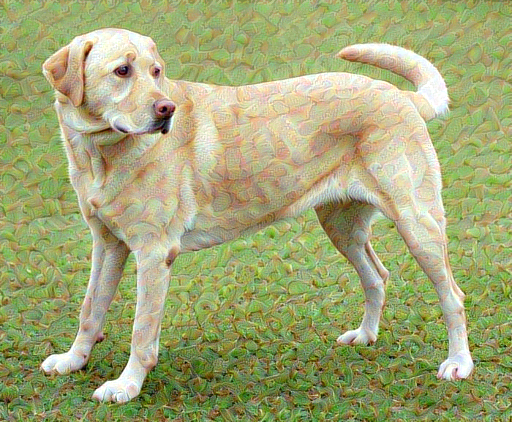

<Figure size 432x432 with 0 Axes>

In [ ]:
plt.figure (figsize = (6,6))
train_step(image,style_weight,content_weight)
train_step(image,style_weight,content_weight)
train_step(image,style_weight,content_weight)
tensor_to_image(image)

<font color = '34388e'>  Dans la cellule ci-dessous, nous utilisons la fonction `train_step` (réalisant une étape d'entraînement) afin d'effectuer plusieurs étapes d'entraînement de l'algorithm de *style transfer*.

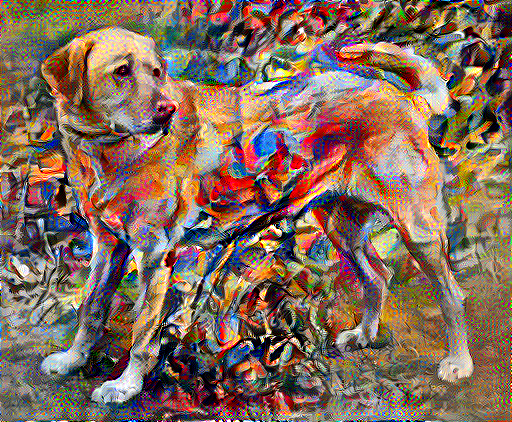

Train step: 10000
Total time: 832.8


In [ ]:
import time
start = time.time()

# Entraînement du réseau 
# --------------------------------
epochs = 100 
steps_per_epoch = 100
loss_vec=[]
loss_content_vec=[]
loss_style_vec=[]
step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    loss, style_loss, content_loss=train_step(image,style_weight,content_weight)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))
  loss_vec.append(loss)
  loss_content_vec.append(content_loss)
  loss_style_vec.append(style_loss)
end = time.time()
print("Total time: {:.1f}".format(end-start))


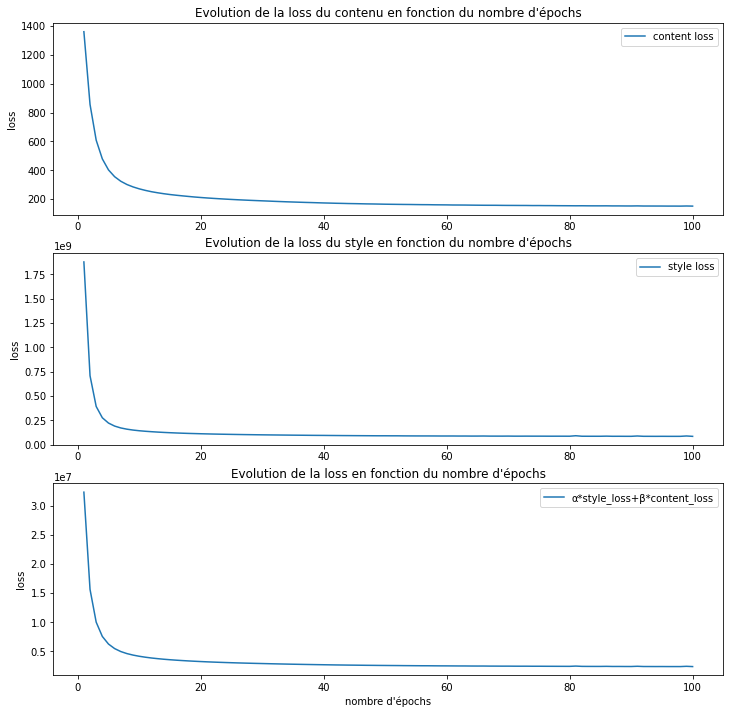

In [ ]:
import matplotlib.pyplot as plt
"""
Tracé de l'évolution de chacune des loss (de contenu, de style, totale variation et total loss)
"""
x = np.arange(1, epochs+1)
content = np.array(loss_content_vec)
loss = np.array(loss_vec)
style = np.array(loss_style_vec)

plt.subplot(311)
plt.plot(x, content, "-", label="content loss")
plt.legend()
plt.title("Evolution de la loss du contenu en fonction du nombre d'épochs")
plt.ylabel("loss")

plt.subplot(312)
plt.plot(x, style, "-", label="style loss")
plt.legend()
plt.title("Evolution de la loss du style en fonction du nombre d'épochs")
plt.ylabel("loss")

plt.subplot(313)
plt.plot(x, loss, "-", label="α*style_loss+β*content_loss")
plt.legend()
plt.title("Evolution de la loss en fonction du nombre d'épochs")
plt.xlabel("nombre d'épochs")
plt.ylabel("loss")
plt.show()

<font color = '34388e'> Ci dessous, voici ce que l'on obtient quand on part de l'image de bruit blanc. On voit qu'il faut beaucoup plus d'itérations pour faire diminuer la loss de contenu. Au bout de 40 itérations, la loss est minimisée avec l'image de contenu à l'initialisation. Il faut 90 itérations pour converger quand on part de l'image de bruit blanc. Cela s'explique car lorsque l'on part de l'image de contenu, on a quasiment rien à apprendre. 
Dans tous les cas la loss de style est beaucoup plus grande que la loss de contenu, mais converge assez vite. Elle converge plus vite quand on part de l'image de bruit blanc que lorsque l'on part de l'image de contenu. En effet pour l'image de bruit, il y a tout à apprendre, donc le style peut etre appris rapidement, alors que lorsque l'on part de l'image de contenu, il est plus long d'apprendre le style, car toute l'information de contenu a déjà été apprise. 

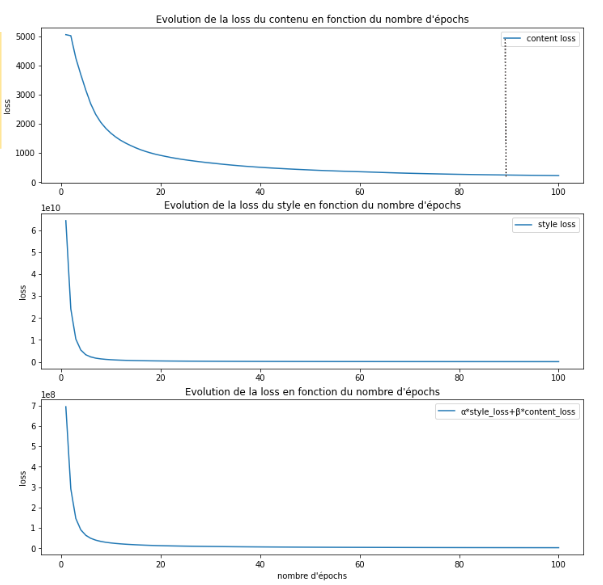

## Total variation loss

<font color = '34388e'> Pour éviter les problèmes d'artefacts dus aux hautes fréquences et permettre plus de régularité dans l'image de sortie, on utilise une perte avec un terme de régularisation appelée **total variation loss**. Le terme de régularisation s'applique aux hautes fréquences de des composantes de l'image.

<font color = '34388e'> On considère les variations spatiales du signal, le long des lignes et le long des colonnes de l’image. Les hautes fréquences spatiales correspondent à un niveau de gris qui varie fortement sur quelques pixels alors que les basses fréquences spatiales correspondent à une variation lente du niveau de gris, par exemple dans une zone de dégradé.

<font color = '34388e'> Ainsi, pour visualiser les hautes fréquences (correspondant à un niveau de gris qui varie fortement), on calcule les dérivées discrètes horizontales et verticales:

<font color = '34388e'> $\Delta_x (\vec{x}) = x_{i,j}-x_{i, j-1}$ 

<font color = '34388e'> $\Delta_y (\vec{x})= x_{i,j}-x_{i-1, j}$ 

<font color = '34388e'>  La fonction `high_pass_x_y` ci-dessous permet de calculer la dérivées discrète horizontale et verticale de l'image d'entrée. 

In [ ]:
def high_pass_x_y(image):
  """ 
  Cette fonction calcule la dérivée discrète horizontale et
  verticale
  """
  x_var = image[:, :, 1:, :] - image[:, :, :-1, :]
  y_var = image[:, 1:, :, :] - image[:, :-1, :, :]

  return x_var, y_var

<font color = '34388e'> Dans la cellule ci-dessous, voit que les fréquences hautes ont augmenté dans l'image après *style transfer* car l'image est très texturée, ce qui génère des variations rapides sur les niveaux de gris, et peut amener à des artefacts sur l'image finale obtenue. 

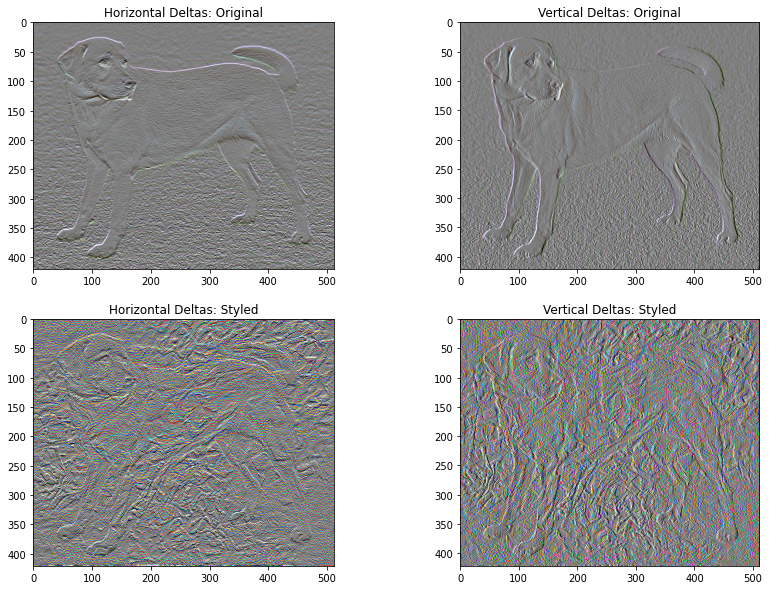

In [ ]:
x_deltas, y_deltas = high_pass_x_y(content_image)

plt.figure(figsize=(14, 10))
plt.subplot(2, 2, 1)
imshow(clip_0_1(2*y_deltas+0.5), "Horizontal Deltas: Original")

plt.subplot(2, 2, 2)
imshow(clip_0_1(2*x_deltas+0.5), "Vertical Deltas: Original")

x_deltas, y_deltas = high_pass_x_y(image)

plt.subplot(2, 2, 3)
imshow(clip_0_1(2*y_deltas+0.5), "Horizontal Deltas: Styled")

plt.subplot(2, 2, 4)
imshow(clip_0_1(2*x_deltas+0.5), "Vertical Deltas: Styled")

<font color = '34388e'>  De plus, on peut remarquer que la composante haute fréquence est un détecteur de bord. Nous pouvons obtenir des résultats similaires à ceux obtenus avec la fonction `high_pass_x_y` ci-dessus en utilisant le détecteur de bords de Sobel :

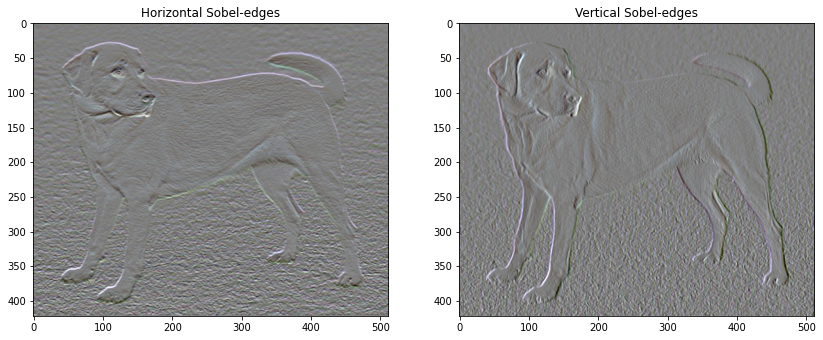

In [ ]:
plt.figure(figsize=(14, 10))

sobel = tf.image.sobel_edges(content_image)
plt.subplot(1, 2, 1)
imshow(clip_0_1(sobel[..., 0]/4+0.5), "Horizontal Sobel-edges")
plt.subplot(1, 2, 2)
imshow(clip_0_1(sobel[..., 1]/4+0.5), "Vertical Sobel-edges")

<font color = '34388e'> Nous recalculons le nouvelle **total loss** en prenant en compte la perte régularisation. On obtient la **total variation loss** : 

\

<font color = '34388e'> $$\mathcal{L}_{\text{total_with_regularization}} (\vec{p},\vec{a},\vec{x}) =
\alpha \mathcal{L}_{content}(\vec{p},\vec{x}) + \beta \mathcal{L}_{style} (\vec{a},\vec{x}) + \gamma \mathcal{L}_{\text{variation_loss}}(\vec{x})$$

<font color = '34388e'> $$ \Leftrightarrow $$

<font color = '34388e'> $$\mathcal{L}_{\text{total_with_regularization}} (\vec{p},\vec{a},\vec{x}) = 
\alpha \mathcal{L}_{content}(\vec{p},\vec{x}) + \beta \mathcal{L}_{style} (\vec{a},\vec{x}) + \gamma (\text| \Delta_x (\vec{x})|+ | \Delta_y(\vec{x})|) $$

<font color = '34388e'>  avec 

<font color = '34388e'> $| \Delta_x (\vec{x})| = \sum_{i=1}^n \sum_{j=2}^n \lvert x_{i,j}-x_{i, j-1} \rvert$ 

<font color = '34388e'> $| \Delta_y (\vec{x})| = \sum_{j=1}^n \sum_{i=2}^n \lvert x_{i,j}-x_{i-1, j} \rvert$ 

<font color = '34388e'>  où on note i=1 (resp. j) la première ligne (resp. colonne) de pixels de l'image et n la dernière colonne de l'image. 



In [ ]:
def total_variation_loss(image):
  """
  Cette fonction est la nouvelle loss totale. C'est la somme de 
  la somme des valeurs absolue des dérivées discrètes horizontales
  et la somme des valeurs absolues des dérivées discrètes verticales. 
  """
  x_deltas, y_deltas = high_pass_x_y(image)
  return tf.reduce_sum(tf.abs(x_deltas)) + tf.reduce_sum(tf.abs(y_deltas))

In [ ]:
total_variation_loss(image).numpy()

207279.12

<font color = '34388e'> Il n'est cependant pas nécessaire d'implémenter la **total variation loss** nous-même car TensorFlow inclut une implémentation standard : 

In [ ]:
tf.image.total_variation(image).numpy()

array([207279.12], dtype=float32)

## Réexécution de l'optimisation

Nous fixons le poids $\gamma$ pour la `total_variation_loss` :

In [ ]:
total_variation_weight=30

<font color = '34388e'>  Nous réimplémentons la fonction `train_step` qui réalise une étape de l'algorithme de *style transfer*. Par rapport à précédemment, nous ajoutons à la **total loss** la **total variation loss**. 

In [ ]:
@tf.function()
def train_step(image,style_weight,content_weight):
  with tf.GradientTape() as tape:
    outputs = extractor(image)
    loss, style_loss, content_loss = style_content_loss(outputs,style_weight,content_weight)
    # On ajoute à la loss total le terme de total_variation_loss. 
    # C'est un terme de régularisation de l'image de sortie. 
    loss += total_variation_weight*tf.image.total_variation(image) 

  grad = tape.gradient(loss, image)
  opt.apply_gradients([(grad, image)])
  image.assign(clip_0_1(image))

  return  loss, style_loss, content_loss, tf.image.total_variation(image) #on récupère toutes les loss (loss totale, style loss, content loss, total_variation_loss)

<font color = '34388e'>  Nous réinitialisons la variable-image et l'optimiseur (Adam):

In [ ]:
opt = tf.keras.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
image = tf.Variable(content_image)

if INITIAIZATION_WHITE_NOISE : #on initialise avec l'image en noir et blanc 
  image = tf.cast(clip_0_1(create_grey_image(image)), tf.float32)
  image = tf.Variable(image)

<font color = '34388e'>  Puis nous utilisons la fonction `train_step` (qui réalise une étape de l'algorithme de *style transfer*) afin de réaliser plusieurs étapes de l'algorithme de *style transfer* afin de reéxécuter l'opitmisation : 

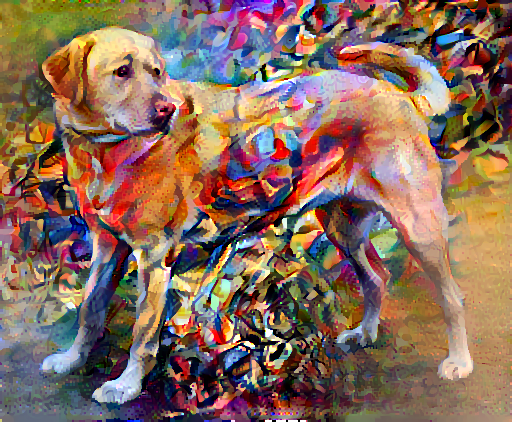

Train step: 10000
Total time: 851.2


In [ ]:
import time
start = time.time()

loss_vec=[]
loss_content_vec=[]
loss_style_vec=[]
tvl_vec=[]
epochs = 100
steps_per_epoch = 100

step = 0
for n in range(epochs):
  for m in range(steps_per_epoch):
    step += 1
    loss, style_loss, content_loss, tvl = train_step(image,style_weight,content_weight)
    print(".", end='', flush=True)
  display.clear_output(wait=True)
  display.display(tensor_to_image(image))
  print("Train step: {}".format(step))
  loss_vec.append(loss)
  loss_content_vec.append(content_loss)
  loss_style_vec.append(style_loss)
  tvl_vec.append(tvl)
end = time.time()
print("Total time: {:.1f}".format(end-start))

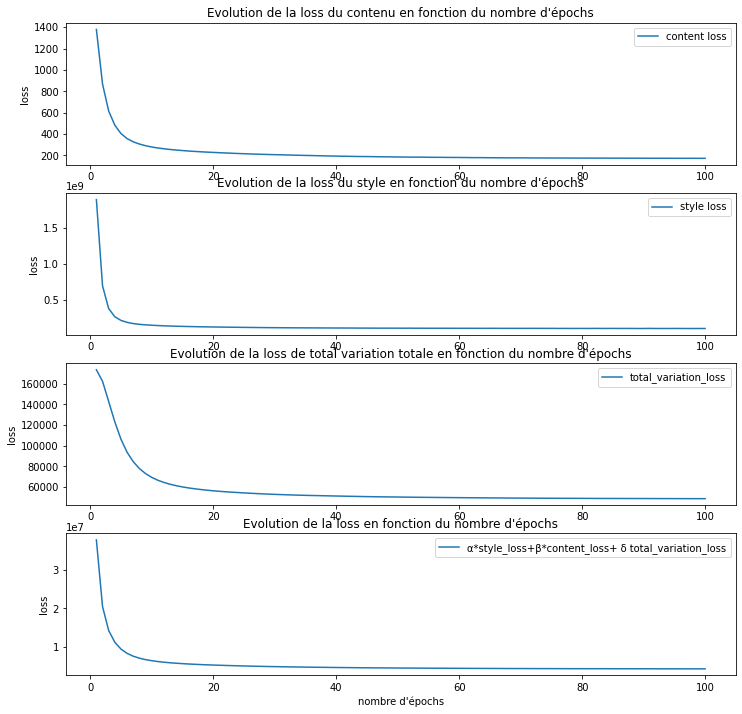

In [ ]:
import matplotlib.pyplot as plt
"""
Tracé de l'évolution de chacune des loss (de contenu, de style, totale variation et total loss)
"""
x = np.arange(1, 100+1)
content = np.array(loss_content_vec)[:100]
loss = np.array(loss_vec)[:100]
style = np.array(loss_style_vec)[:100]
totalvar = np.array(tvl_vec)[:100]

plt.subplot(411)
plt.plot(x, content, "-", label="content loss")
plt.legend()
plt.title("Evolution de la loss du contenu en fonction du nombre d'épochs")
plt.ylabel("loss")

plt.subplot(412)
plt.plot(x, style, "-", label="style loss")
plt.legend()
plt.title("Evolution de la loss du style en fonction du nombre d'épochs")
plt.ylabel("loss")

plt.subplot(413)
plt.plot(x, totalvar, "-", label="total_variation_loss")
plt.legend()
plt.title("Evolution de la loss de total variation totale en fonction du nombre d'épochs")
plt.ylabel("loss")

plt.subplot(414)
plt.plot(x, loss, "-", label="α*style_loss+β*content_loss+ δ total_variation_loss")
plt.legend()
plt.title("Evolution de la loss en fonction du nombre d'épochs")
plt.xlabel("nombre d'épochs")
plt.ylabel("loss")
plt.show()

<font color = '34388e'>  Nous sauvegardons finalement le résultat :

<text color ="blue"> Quand on part de l'image de contenu (image ci dessus), on voit comme précédemment que la loss de contenu est bien plus rapide à décroitre. Cela est normal, car on lui donne l'image de contenu donc l'algorithme a déjà quasiment accès à tout l'information de contenu de l'image. La loss de variation totale est aussi plus lente à décroitre quand on part d'une image de bruit blanc. Cela est du à qu'à chaque itération, l'algorithme doit apprendre à la fois le contenu et le style ce qui fait varier pendant longtemps les gradients discrets de l'image (à la fois horizontal et vertical). 

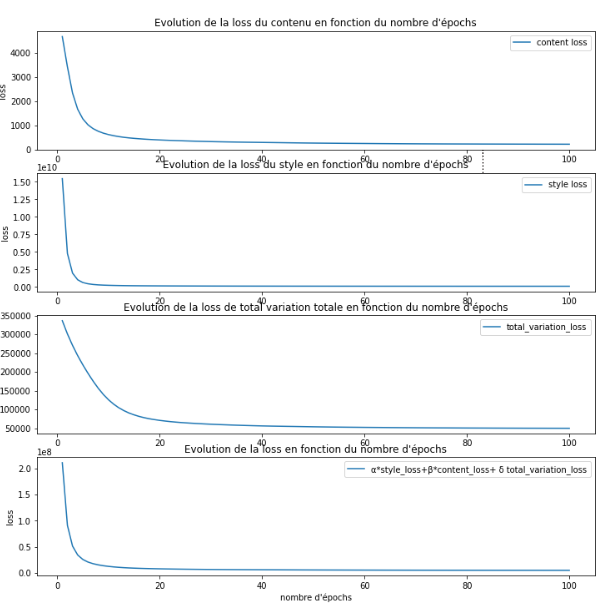

In [ ]:
file_name = 'stylized-image.png'
tensor_to_image(image).save(file_name)

try:
  from google.colab import files
except ImportError:
   pass
else:
  files.download(file_name)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<font color = '34388e'> Ce tutoriel présente l'algorithme original de transfert de style. Pour une application simple du transfert de style, consultez ce [tutoriel](https://www.tensorflow.org/hub/tutorials/tf2_arbitrary_image_stylization) pour en savoir plus sur la façon d'utiliser le modèle de transfert de style d'images arbitraires de [TensorFlow Hub](https://tfhub.dev).


# Tests

### **Rapports entre Beta et Alpha avec une image sans bruit blanc**

<font color = '34388e'>  On prend les images suivantes de contenu (à gauche) et de style (à droite) pour réaliser nos tests.

In [ ]:
path_test_content = 'photo_corse.jpg'
path_test_style = 'pointillisme.png'
test_content_image = load_img(path_test_content)
test_style_image = load_img(path_test_style)

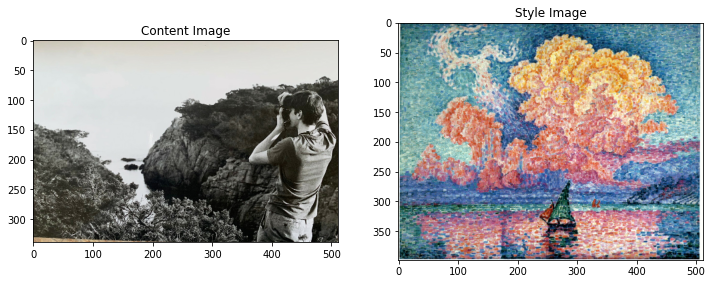

In [ ]:
plt.subplot(1, 2, 1)
imshow(test_content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(test_style_image, 'Style Image')

<font color = '34388e'>  On teste différents rapports entre alpha et beta avec alpha fixé à 5 et beta qui varie

In [ ]:
path_test_beta20 = 'photo_style_corse_signac_alpha5beta20.png'
path_test_beta40 = 'photo_style_corse_signac_beta40.png'
path_test_beta500 = 'photo_style_corse_signac_alpha5_beta500.png'
path_test_beta5000 = 'photo_style_corse_signac_alpha5beta5000.png'
test_beta20 = load_img(path_test_beta20)
test_beta40 = load_img(path_test_beta40)
test_beta500 = load_img(path_test_beta500)
test_beta5000 = load_img(path_test_beta5000)

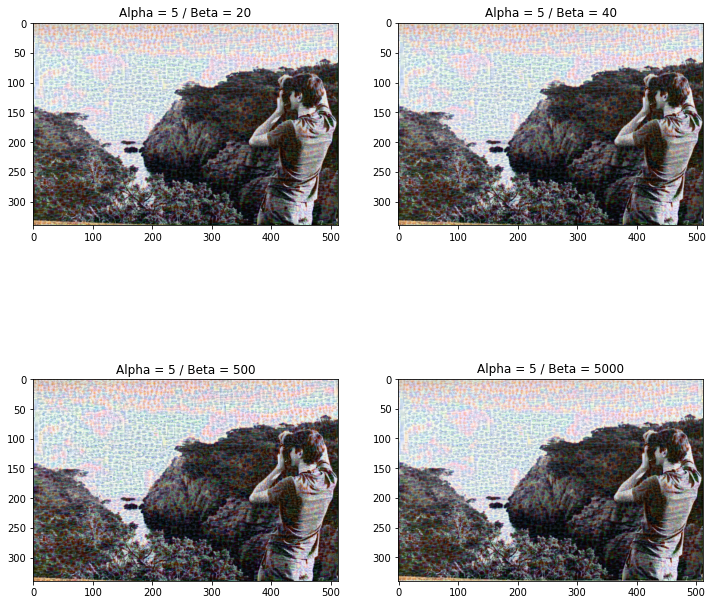

In [ ]:
plt.subplot(2, 2, 1)
imshow(test_beta20, 'Alpha = 5 / Beta = 20')

plt.subplot(2, 2, 2)
imshow(test_beta40, 'Alpha = 5 / Beta = 40')

plt.subplot(2, 2, 3)
imshow(test_beta500, 'Alpha = 5 / Beta = 500')

plt.subplot(2, 2, 4)
imshow(test_beta5000, 'Alpha = 5 / Beta = 5000')

<font color = '34388e'>  On ne voit pas de très grandes différences en faisant varier les paramètres 

<font color = '34388e'>  Voir s'il y a des différences plus grandes si on prend un rapport plus faible

### <font color = '34388e'>  **Tests sur le rapport $\alpha$ / $\beta$ avec une image de contenu et de bruit blanc**

<font color = '34388e'> **Tests sur l'image de contenu**

<font color = '34388e'> - L'image **a** est le résultat obtenu pour $\alpha$ et $\beta$ tous deux égaux à 1. On y constate un bon équilibre entre le contenu (on arrive à reconnaître le chien), et le style, également très présent.

<font color = '34388e'> - Sur l'image **b**, le style est beaucoup plus pénalisé que le contenu car $\beta > \alpha$. On constate que l'image est similaire à l'image **a** car le contenu est déjà présent au départ donc il ne peut pas être effacé.

<font color = '34388e'> - Sur l'image **c**, le contenu est beaucoup plus pénalisé que le style car $\beta < \alpha$, dans ce cas là on reconnait très bien la photographie d'origine qui garde même ses couleurs initiales, le style est très peu présent. 

<font color = '34388e'> **Tests sur l'image de bruit blanc**

<font color = '34388e'> Pour obtenir des images similaires en partant d'une image de bruit blanc, il faut changer les valeurs des paramètres $\alpha$ et $\beta$. En effet, partant d'une image de bruit blanc, l'apprentissage du contenu est plus difficile. Ainsi, pour pouvoir reconnaitre le chien, il faut pénaliser le style beaucoup plus que le contenu. On fixe $\alpha=1$ sur tous les tests. 
<font color = '34388e'> - Pour $\beta=10^{-12}$ (Figure **c**) on remarque que l'on s'approche du résultat obtenu avec $\beta=10^{-9}$ en partant de l'image de contenu (Figure **c**). 
<font color = '34388e'> - Pour $\beta=1$ (Figure  **b**), on obtient une image sur laquelle on ne reconnait plus du tout le chien, le contenu n'a pas été appris. 
<font color = '34388e'> - Enfin, pour $\beta=10^{-6}$  (Figure **a**) on obtient une image où le style et le contenu sont mélangés équitablement et tous deux reconnaissables, ce qui est similaire au résultat obtenu en partant de l'image de contenu avec $\beta = 10^{9}$ (Figure **a** ). 

<font color = '34388e'> **Tests sur l'image de bruit blanc avec application de la total variation loss**

<font color = '34388e'> On refait des tests en partant de l'image de bruit blanc, avec les mêmes valeurs de ratio $\alpha$ / $\beta$ que pour les tests sur l'image de bruit blanc, mais en ajoutant la total variation loss. On observe que les images obtenues sont plus lisses que sans la variation loss. En particulier, sur la Figure **c**, l'application de la totale variation loss permet de retrouver une image qui semble identique à l'oeil à l'image de départ, alors que l'image Figure  **c** sans variation loss restait très bruitée. L'application de la total variation loss a effacé les artefacts. 

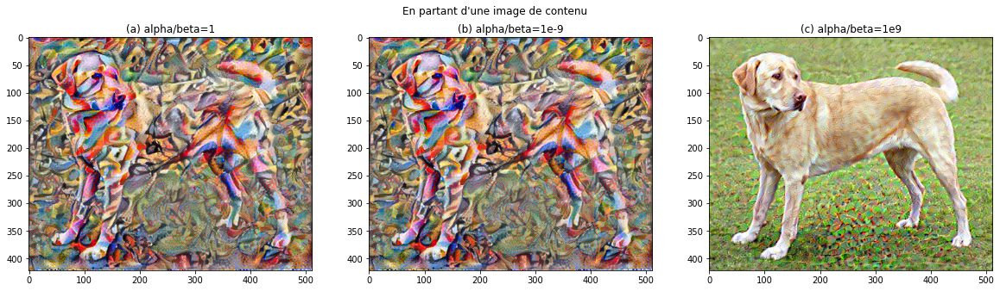

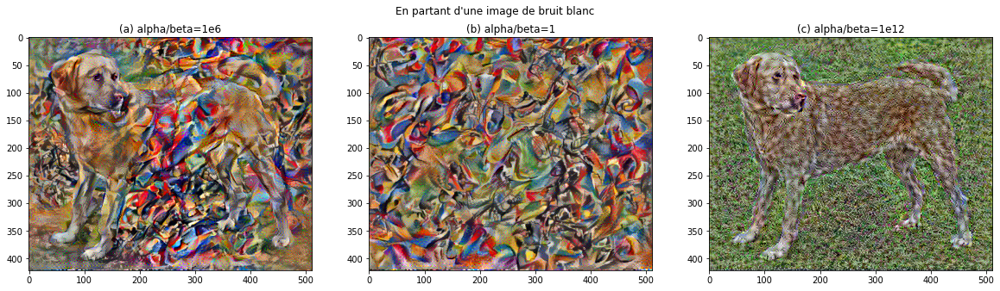

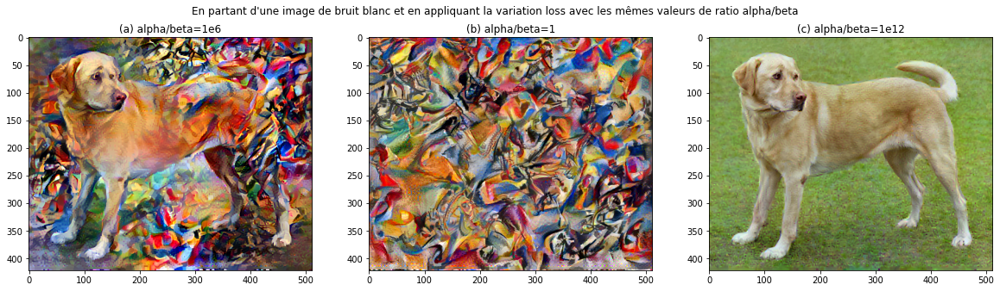

In [ ]:
path_test_alpha_beta = 'tests_alpha_beta_content_noise'
im_content = ['alpha1_beta1_epochs10.png', 'alpha1_beta109_epochs10.png', 'alpha1_beta10-9_epochs10.png']
im_noise = ['alpha1_beta10-6_epochs100_noise.png', 'alpha1_beta1_epochs100_noise.png', 'alpha1_beta10-12_epochs100_noise.png']
im_noise_variation_loss = ['alpha1_beta10-6_total_variation_loss.png', 'alpha1_beta1_total_variation_loss.png', 'alpha106_beta10-6_total_variation_loss.png']
title_content = ['1','1e-9','1e9']
title_noise = ['1e6','1','1e12']
num_im = ['a','b','c']

plt.figure(figsize=(20,5))
for i in range(len(im_content)) :
  path_file = os.path.join(path_test_alpha_beta,im_content[i])
  test_image = load_img(path_file)
  plt.subplot(1,len(im_content),i+1)
  imshow(test_image, '('+num_im[i]+')'+ ' alpha/beta='+str(title_content[i]))
  i += 1
plt.suptitle("En partant d'une image de contenu")
plt.show()

plt.figure(figsize=(20,5))
for i in range(len(im_noise)) :
  path_file = os.path.join(path_test_alpha_beta,im_noise[i])
  test_image = load_img(path_file)
  plt.subplot(1,len(im_noise),i+1)
  imshow(test_image, '('+num_im[i]+')'+' alpha/beta='+str(title_noise[i]))
  i += 1
plt.suptitle("En partant d'une image de bruit blanc")
plt.show()

plt.figure(figsize=(20,5))
for i in range(len(im_noise_variation_loss)) :
  path_file = os.path.join(path_test_alpha_beta,im_noise_variation_loss[i])
  test_image = load_img(path_file)
  plt.subplot(1,len(im_noise_variation_loss),i+1)
  imshow(test_image, '('+num_im[i]+')'+' alpha/beta='+str(title_noise[i]))
  i += 1
plt.suptitle("En partant d'une image de bruit blanc et en appliquant la variation loss avec les mêmes valeurs de ratio alpha/beta")
plt.show()

### **Tests sur l'extraction des feature maps des différentes couches de convolution du style avec différentes valeurs du ratio $\alpha$ / $\beta$**


<font color = 'blue'> **Description du test :**
Les tests ci-dessous illustrent l'aspect de l'image obtenue en sortie des différentes features map définies pour l'extraction du style. On rappelle que le modèle est défini à partir de 5 couches de convolutions: Conv1_1, Conv2_1, Conv3_1, Conv4_1 et Conv5_1. 

<font color = 'blue'> Pour extraire ces features map, on a créé la fonction **select_layers** qui permet de choisir les couches de convolution que l'on utilise pour le style. Ensuite on fait tourner le modèle de la même manière que d'habitude après avoir fixé une valeur de $\alpha$ et $\beta$. 

<font color = 'blue'> On fait également varier la valeur du ratio $\alpha$ / $\beta$ pour pénaliser plus ou moins le contenu ou le style. Le paramètre $\alpha$ est fixé à 1 pour tous les tests, et le paramètre $\beta$ prend les valeurs $10^{-6}, 10^{-3}, 1, 10^{3}, 10^{6}$. Ainsi, pour les faibles valeurs de beta, le style est plus pénalisé que le contenu et pour les fortes valeurs de beta le contenu est plus pénalisé que le style. Quand $\alpha=\beta=1$, le contenu et le style ont la même pénalisation. 

<font color = 'blue'> **Commentaires sur les résultats :**

<font color = 'blue'> De manière générale, on observe que plus l'on descend profondémment dans les couches et plus l'image est stylisée. La structure locale des images capturées par le style augmente en taille et en complexité quand on inclut les feature maps des couches les plus profondes. D'après l'article, cela peut s'expliquer par l'augmentation de la taille des champs réceptifs et de la complexité des features tout au long du traitement de l'image par le réseau.

<font color = 'blue'> - Par exemple, sur la feature map de la première couche de convolution, on observe que si le style est très pénalisé ($\beta=10^{-6}$), l'image obtenue semble identique à l'oeil avec l'image d'origine. Par ailleurs, même lorsque le facteur $\beta$ est grand, on reconnait très bien le chien, et on reconnait peu le style du tableau d'origine. 

<font color = 'blue'> - A l'inverse, la feature map de la 5ème couche de convolution est marquée par un style plus important et reconnaissable pour toute les valeurs de $\beta$. Les images de la 5ème couche de convolution sont affichées en plus grand en dessous pour distinguer les différences selon les valeurs de $\alpha$ et $\beta$ qui sont plus fines. La différence la plus notable porte sur l'image obtenue pour $\beta=10^{6}$. Pour cette valeur, on distingue mieux les caractéristiques de la tête du chien et le reste de son corps se détache également mieux du fond. 

<font color = 'blue'> Concernant la pénalisation plus ou moins importante du style ou du contenu, on observe bien que plus $\beta$ est grand, plus le style de l'image est similaire à celui du tableau d'origine. Sur les feature maps des couches de convolution les plus profondes (4 et 5), le chien a même tendance à se fondre dans l'arrière plan. D'autre part, sur les couches de convolution 1, 2 et 3 qui sont plus superficielles, on observe que plus $\beta$ est grand, plus la feature map est similaire à l'image d'origine. Pour $\beta=10^{-6}$ on a même conservé les couleurs de l'image d'origine, le style du tableau a donc était très peu extrait. 

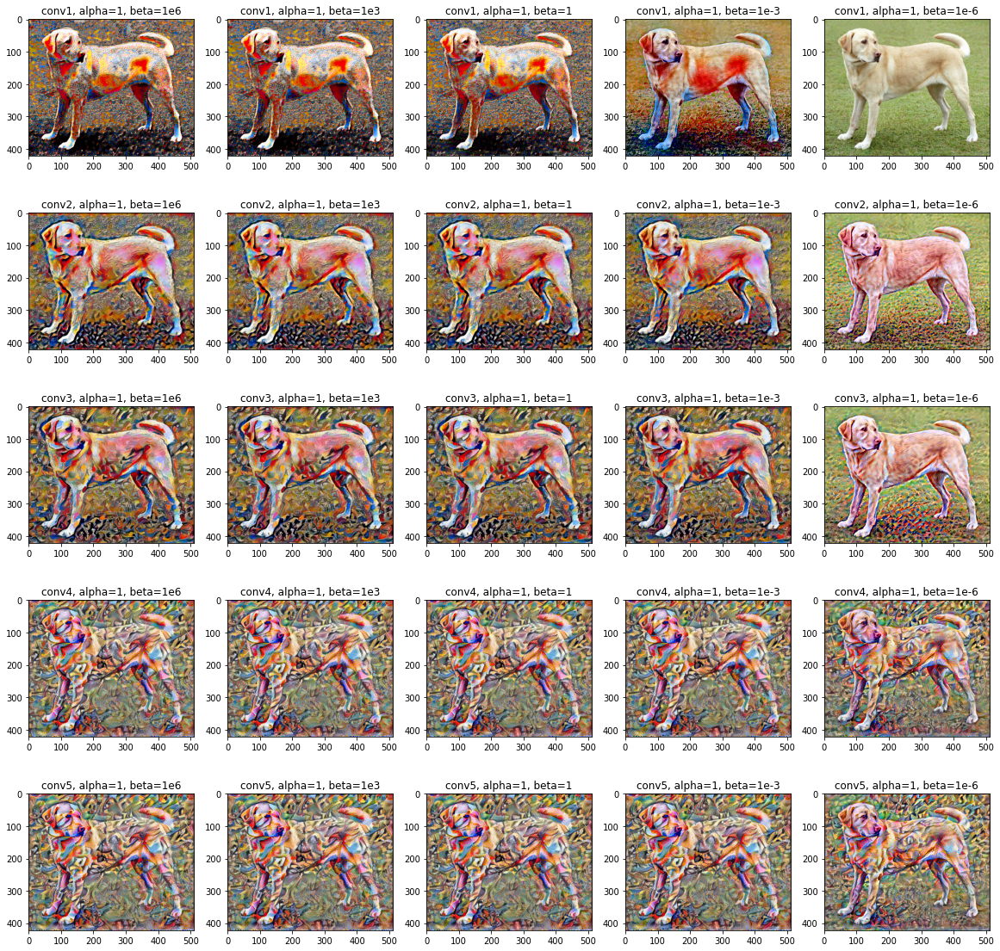

In [ ]:
path_test_conv = 'test_on_convolutional_layers'
directories = ['conv1', 'conv2', 'conv3', 'conv4', 'conv5']
liste_beta = ["106","103","1","10-3","10-6"]
title_beta = ["1e6","1e3","1","1e-3","1e-6"]
i = 1
plt.figure(figsize=(20,20))
for d in directories :
  for b in range(len(liste_beta)) : 
    file_name = 'alpha1_beta' + liste_beta[b] + '_epochs10_' + d + '.png'
    path_file = os.path.join(path_test_conv,d,file_name)
    test_image = load_img(path_file)
    plt.subplot(len(directories), len(liste_beta), i)
    imshow(test_image, d+ ', alpha=1, beta='+str(title_beta[b]))
    i += 1

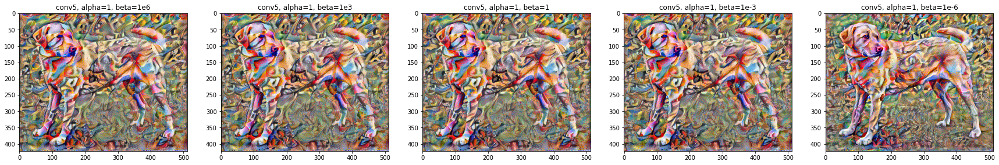

In [ ]:
# Affichage en plus grand des features map de la dernière couche de convolution pour différentes valeurs de alpha et beta
plt.figure(figsize=(30,5))
d = directories[4]
i = 1
for b in range(len(liste_beta)) : 
  file_name = 'alpha1_beta' + liste_beta[b] + '_epochs10_' + d + '.png'
  path_file = os.path.join(path_test_conv,d,file_name)
  test_image = load_img(path_file)
  plt.subplot(1, len(liste_beta), i)
  imshow(test_image, d+ ', alpha=1, beta='+str(title_beta[b]))
  i += 1

<font color = 'blue'> **Deuxième test :**
On refait le même test que précédemment mais en utilisant cette fois la total variation loss. On extrait donc la feature map obtenue pour chaque couche du réseau de neurones et on fait varier le ratio alpha et beta de la même manière que précédemment. Nous avons fixé $\alpha$ à $10^3$ cette fois car nous avons constaté que quand $\alpha$ était fixé à 1, des erreurs pouvaient apparaître lors de l'exécution de l'algorithme. En fixant $\alpha$ à $10^3$ les erreurs disparaissent. Nous avons donc adapté les valeurs de $\beta$ pour conserver les mêmes ratios étudiés que dans la partie précédente. Les valeurs de $\beta$ étudiées sont : $10^{-3}$, $1$, $10^3$, $10^6$ et $10^9$.
<font color = 'blue'>

<font color = 'blue'> **Commentaires sur les résultats :**

<font color = 'blue'> On observe des résultats légèrement différents que pour le test précédent, notamment dans les premières couches du réseau de neurones et plus particulièrement pour les ratios $\alpha/\beta$ grands. L'utilisation de la total variation loss permet de construire des applats de couleurs plutôt intenses dans les premières couches. On remarque également que plus on descend profondément dans les couches et plus l'image est stylisée. De même, on retrouve bien que plus $\beta$ est grand, plus le style de l'image est similaire à celui du tableau d'origine. Dans les dernières couches de convolution du réseau de neurones (4 et 5), on remarque également que le chien tend à se confondre avec le reste de l'image stylisée. 

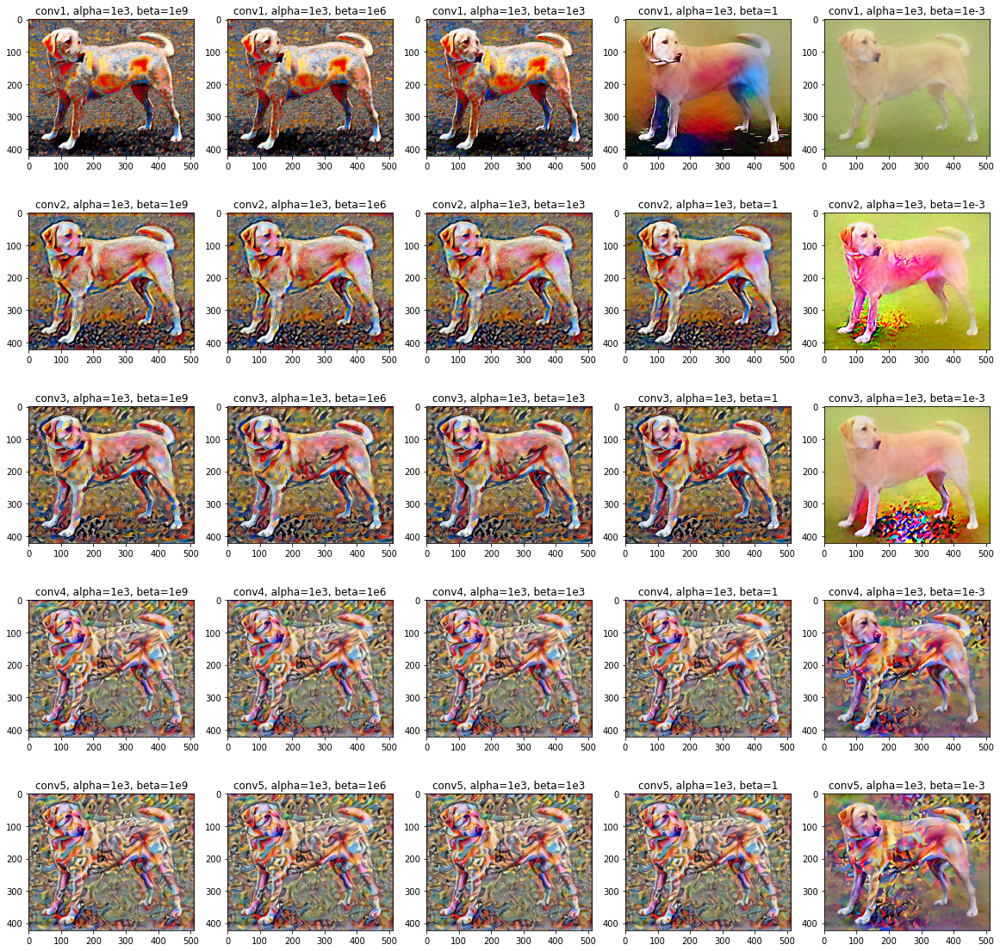

In [ ]:
path_test_conv = 'test_total_variation_loss'
directories = ['conv1', 'conv2', 'conv3', 'conv4', 'conv5']
liste_beta = ["109","109","103","1","10-3"]
title_beta = ["1e9","1e6","1e3","1","1e-3"]
i = 1
plt.figure(figsize=(20,20))
for d in directories :
  for b in range(len(liste_beta)) : 
    file_name = 'test2_chien_alpha103_beta' + liste_beta[b] + '_epoch10_' + d + '_total_variation.png'
    path_file = os.path.join(path_test_conv,d,file_name)
    test_image = load_img(path_file)
    plt.subplot(len(directories), len(liste_beta), i)
    imshow(test_image, d+ ', alpha=1e3, beta='+str(title_beta[b]))
    i += 1

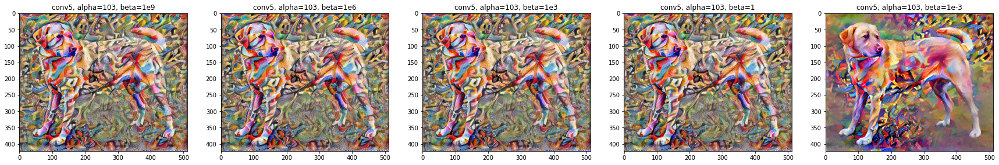

In [ ]:
# Affichage en plus grand des features map de la dernière couche de convolution pour différentes valeurs de alpha et beta
plt.figure(figsize=(30,5))
d = directories[4]
i = 1
liste_beta = ["109","109","103","1","10-3"]
title_beta = ["1e9","1e6","1e3","1","1e-3"]
for b in range(len(liste_beta)) : 
  file_name = 'test2_chien_alpha103_beta' + liste_beta[b] + '_epoch10_' + d + '_total_variation.png'
  path_file = os.path.join(path_test_conv,d,file_name)
  test_image = load_img(path_file)
  plt.subplot(1, len(liste_beta), i)
  imshow(test_image, d+ ', alpha=103, beta='+str(title_beta[b]))
  i += 1

# <font color="blue">  Tests réalisés sur un portrait avec différents styles de peinture pour les portraits 

<font color="blue"> Dans cette section, nous avons essayé de réaliser des tests pour une image d'un visage (ici Julia Roberts)
sur laquelle nous avons appliqué un transfert de style d'une oeuvre avec un portrait. Les sept styles appliqués ici sont ceux 
des oeuvres ci-dessous : 
- <font color="blue"> Les Amazones Parisiennes - Frida Khalo 
- Vertumne - Giuseppe Arcimboldo 
- La Joconde - Léonard de Vinci 
- La Jeune Fille à la perle - Johannes Vermeer
- Marilyn - Andy Warhol
- Portrait - Pablo Picasso 
- Portrait de l'artiste - Vincent Van Gogh

<font color="blue"> Pour ces tests nous avons fixé le paramètre $\alpha$ à 1 et avons varié le paramètre $\beta$ dans $[10^9, 10^6, 10^3, 1, 10^{-3}, 10^{-6}]$.
On observe bien que plus $\beta$ est grand, plus on s'approche de l'image de contenu d'origine. Dans tous les cas 
pour $\beta = 10^9$, on observe à peu près les mêmes résultats. Au contraire, plus on diminue $\beta$, plus on donne de l'importance 
au style. Les cas pour lesquels nous reconnaissons le style de l'image originale tout en observant bien l'image de contenu
orginale sont les trois derniers (Andy Warhol, Pablo Picasso, Vincent Van Gogh). En effet, le style de ces tableaux étant 
davantage marqué et facilement reconnaissable, ils aboutissent à de meilleurs résultats par rapport aux autres. En particulier, 
nous remarquons que pour les cheveux les résultats sont très proches des images originales que ce soit au niveau des couleurs mais aussi de la forme. 

In [ ]:
im_oeuvres = ['frida_khalo.jpg', 'fruits.jpg', 'joconde.jpg', 'laitiere.jpg', 'marilyn.jpg', 'picasso.jpg', 'vangogh.jpg']
liste_oeuvres = ['Frida Khalo', 'Arcimboldo ', 'Vinci', 'Vermeer', 'Warhol', 'Picasso', 'Van Gogh']

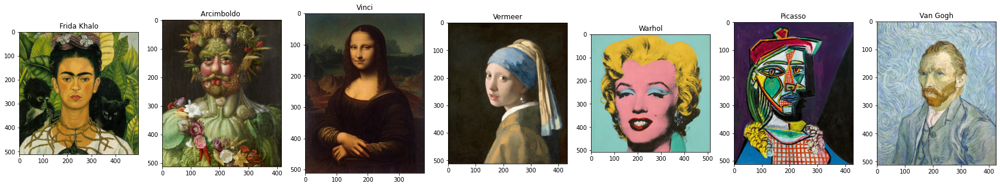

In [ ]:
i = 1
plt.figure(figsize=(30,30))
for idx in range(len(im_oeuvres)) :  
  test_image = load_img(im_oeuvres[idx])
  plt.subplot(1, len(im_oeuvres), i)
  imshow(test_image, liste_oeuvres[idx])
  i += 1

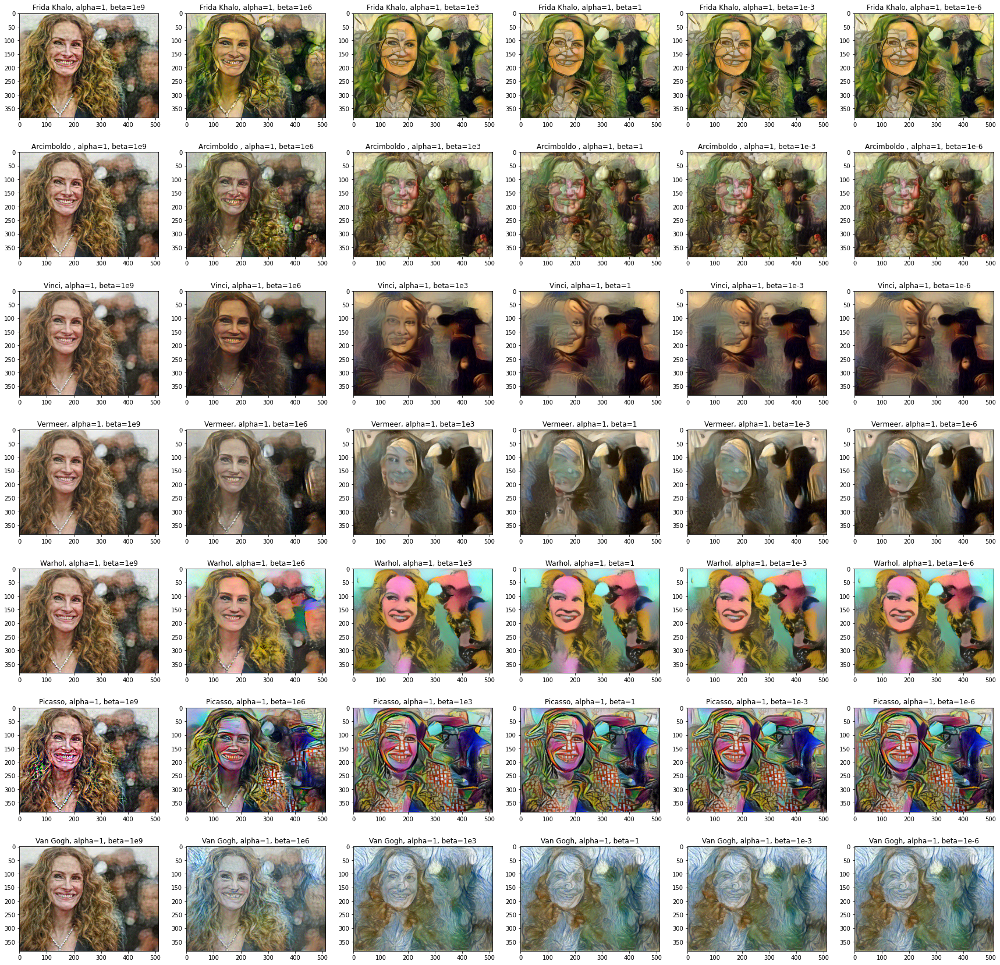

In [ ]:
path_test_conv = 'test_portraits'
directories = ['test_frida_alpha1', 'test_fruits_alpha1', 'test_joconde_alpha1', 'test_laitiere_alpha1', 'test_marilyn_alpha1', 'test_picasso_alpha1', 'test_vangogh_alpha1']
liste_beta = ["1e9", "1e6","1e3","1","1e-3","1e-6"]
title_beta = ["1e9", "1e6","1e3","1","1e-3","1e-6"]
i = 1
j = 0
plt.figure(figsize=(30,30))
for d in directories :
  for b in range(len(liste_beta)) :  
    file_name = 'beta_' + liste_beta[b] + '.png'
    path_file = os.path.join(path_test_conv,d,file_name)
    test_image = load_img(path_file)
    plt.subplot(len(directories), len(liste_beta), i)
    imshow(test_image, liste_oeuvres[j] + ', alpha=1, beta='+str(title_beta[b]))
    i += 1
  j+=1